## Practice: RT --> RRT
---

Key Aspects:
- **Random Tree (RT):**  
  - Generates a random point in the space.  
  - Connects it to a **random** node in the existing tree.  
  - This can result in inefficient exploration, with clusters forming in already explored areas.  
- **Rapidly-exploring Random Tree (RRT):**  
  - Generates a random point in the space.  
  - Connects it to the **nearest** node in the existing tree.  
  - This ensures efficient exploration by growing outward and avoiding redundant expansion.  

The key difference between **Random Tree (RT)** and **Rapidly-exploring Random Tree (RRT)** in terms of how new nodes are connected. We expect **RRT expands more systematically** while RT can be more chaotic.

---

### **Python Implementation**
The following code simulates **RT** using Matplotlib for visualization.

- **RT Tree (Random Tree)** → Chaotic growth, some areas heavily clustered.
  - Try change starting point position
  - Try change number of tries
- Can you extend this to RRT?
  - What if we add some obstacles?

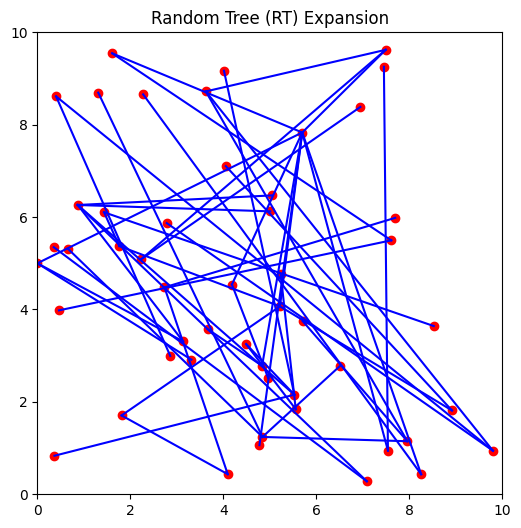

In [1]:
import numpy as np
import matplotlib.pyplot as plt

class Tree:
    def __init__(self, start):
        self.nodes = [start]  # List of nodes (points)
        self.edges = []  # Connections between nodes

    def add_node(self, new_point, parent_point):
        self.nodes.append(new_point)
        self.edges.append((parent_point, new_point))

    def nearest_node(self, point):
        """Find the nearest node in the tree to the given point"""
        pass

def generate_random_point(bounds):
    """Generate a random point within given bounds"""
    return (np.random.uniform(bounds[0], bounds[1]), np.random.uniform(bounds[2], bounds[3]))

def grow_tree_RT(tree, bounds):
    """Random Tree (RT) Expansion: Connects a new point to a random existing node"""
    new_point = generate_random_point(bounds)
    parent_point = tree.nodes[np.random.randint(len(tree.nodes))]  # Choose a random existing node
    tree.add_node(new_point, parent_point)

def grow_tree_RRT(tree, bounds):
    """Rapidly-exploring Random Tree (RRT) Expansion: Connects a new point to the nearest node"""
    pass

def plot_tree(tree, title):
    """Plot the tree structure"""
    plt.figure(figsize=(6,6))
    for edge in tree.edges:
        plt.plot([edge[0][0], edge[1][0]], [edge[0][1], edge[1][1]], 'b-')
    plt.scatter(*zip(*tree.nodes), c='red', marker='o')
    plt.title(title)
    plt.xlim(0, 10)
    plt.ylim(0, 10)
    plt.show()

# Initialize trees
start_position = (0, 5)
rt_tree = Tree(start_position)
rrt_tree = Tree(start_position)

# Grow trees
num_of_tries = 50
for _ in range(num_of_tries):
    grow_tree_RT(rt_tree, (0, 10, 0, 10))
    #grow_tree_RRT(rrt_tree, (0, 10, 0, 10))

# Plot results
plot_tree(rt_tree, "Random Tree (RT) Expansion")
# plot_tree(rrt_tree, "Rapidly-exploring Random Tree (RRT) Expansion")

Here is a reference implementation of RRT

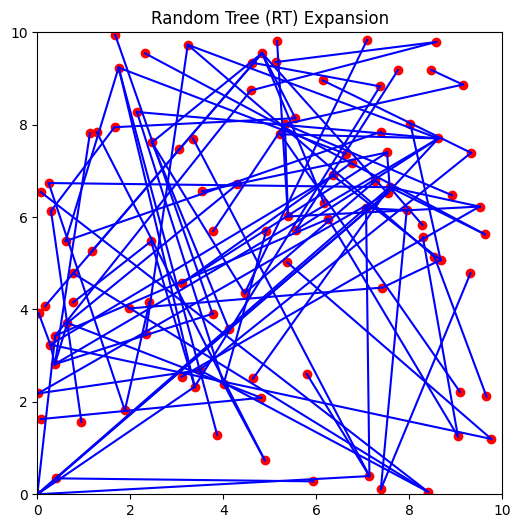

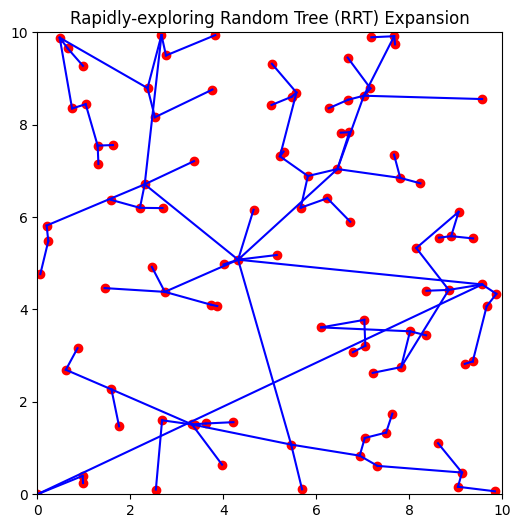

In [2]:
import numpy as np
import matplotlib.pyplot as plt

class Tree:
    def __init__(self, start):
        self.nodes = [start]  # List of nodes (points)
        self.edges = []  # Connections between nodes

    def add_node(self, new_point, parent_point):
        self.nodes.append(new_point)
        self.edges.append((parent_point, new_point))

    def nearest_node(self, point):
        """Find the nearest node in the tree to the given point"""
        return min(self.nodes, key=lambda n: np.linalg.norm(np.array(n) - np.array(point)))

def generate_random_point(bounds):
    """Generate a random point within given bounds"""
    return (np.random.uniform(bounds[0], bounds[1]), np.random.uniform(bounds[2], bounds[3]))

def grow_tree_RT(tree, bounds):
    """Random Tree (RT) Expansion: Connects a new point to a random existing node"""
    new_point = generate_random_point(bounds)
    parent_point = tree.nodes[np.random.randint(len(tree.nodes))]  # Choose a random existing node
    tree.add_node(new_point, parent_point)

def grow_tree_RRT(tree, bounds):
    """Rapidly-exploring Random Tree (RRT) Expansion: Connects a new point to the nearest node"""
    new_point = generate_random_point(bounds)
    parent_point = tree.nearest_node(new_point)  # Find the nearest node
    tree.add_node(new_point, parent_point)

def plot_tree(tree, title):
    """Plot the tree structure"""
    plt.figure(figsize=(6,6))
    for edge in tree.edges:
        plt.plot([edge[0][0], edge[1][0]], [edge[0][1], edge[1][1]], 'b-')
    plt.scatter(*zip(*tree.nodes), c='red', marker='o')
    plt.title(title)
    plt.xlim(0, 10)
    plt.ylim(0, 10)
    plt.show()

# Initialize trees
start_position = (0, 0)
rt_tree = Tree(start_position)
rrt_tree = Tree(start_position)

# Grow trees
for _ in range(100):
    grow_tree_RT(rt_tree, (0, 10, 0, 10))
    grow_tree_RRT(rrt_tree, (0, 10, 0, 10))

# Plot results
plot_tree(rt_tree, "Random Tree (RT) Expansion")
plot_tree(rrt_tree, "Rapidly-exploring Random Tree (RRT) Expansion")

### Challenge for Extra Credit (3 pts in overall grade)

1. Add obstacles
  - Use something like this to define the obstacles (start and goal position are also defined)
```python
# Define environment
start_position = (1, 1)
goal = (9, 9)
obstacles = [(3, 3, 2, 2), (6, 6, 2, 2), (2, 7, 2, 1)]  # (x, y, width, height)
```
  - Need additional logic to check if the path has collisions with the obstacles
2. Implement RRT*
3. Show in animation the progress of the pathfinding process of RRT* in an environment with obstacles
  - Animation means when the code is running, the graph shows every new node added to the tree step by step, instead of the graph shows all the nodes added at the end of the process.

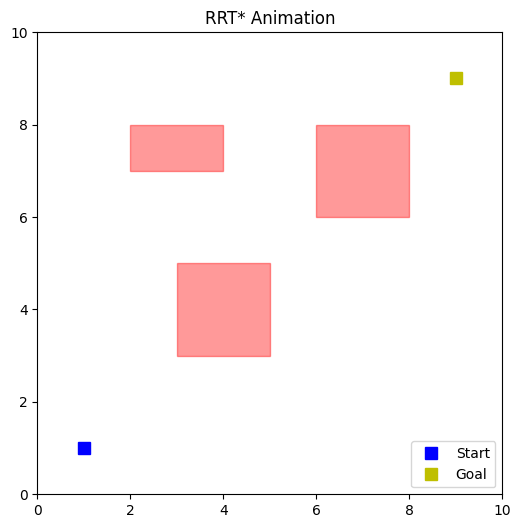

In [3]:
import math
import random
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.animation import FuncAnimation

# --------------------------------------------------------
# Global Configuration / Hyperparameters
# --------------------------------------------------------
MAX_ITER = 500                # Maximum number of iterations
STEP_SIZE = 0.3               # Step size when steering
NEIGHBOR_RADIUS = 1.0         # Radius for rewiring in RRT*
GOAL_THRESHOLD = 0.5          # Stop if we find a node this close to goal
WORLD_X_MAX = 10
WORLD_Y_MAX = 10

start_position = (1, 1)
goal_position = (9, 9)

# (x, y, width, height) for rectangular obstacles
obstacles = [(3, 3, 2, 2), (6, 6, 2, 2), (2, 7, 2, 1)]


# --------------------------------------------------------
# Helper Classes and Functions
# --------------------------------------------------------
class Node:
    def __init__(self, x, y):
        self.x = x
        self.y = y
        self.parent = None
        self.cost = 0.0

def distance(n1, n2):
    return math.hypot(n2.x - n1.x, n2.y - n1.y)

def distance_point(n, pt):
    return math.hypot(pt[0] - n.x, pt[1] - n.y)

def sample_random_point():
    """Sample a random point within the [0, WORLD_X_MAX] x [0, WORLD_Y_MAX] region."""
    return (random.uniform(0, WORLD_X_MAX), random.uniform(0, WORLD_Y_MAX))

def steer(from_node, to_point, step_size=STEP_SIZE):
    """
    Returns a new node in the direction from 'from_node' to 'to_point'
    with a distance up to 'step_size'.
    """
    theta = math.atan2(to_point[1] - from_node.y, to_point[0] - from_node.x)
    dist = distance_point(from_node, to_point)
    if dist < step_size:
        new_x, new_y = to_point[0], to_point[1]
    else:
        new_x = from_node.x + step_size * math.cos(theta)
        new_y = from_node.y + step_size * math.sin(theta)

    new_node = Node(new_x, new_y)
    new_node.cost = from_node.cost + step_size
    new_node.parent = from_node
    return new_node

def is_in_obstacle(point, obstacles):
    """Check if a point is inside any of the rectangular obstacles."""
    px, py = point
    for (ox, oy, w, h) in obstacles:
        if ox <= px <= ox + w and oy <= py <= oy + h:
            return True
    return False

def collision_free(node1, node2, obstacles):
    """
    Check if the straight line from node1 to node2
    collides with any obstacle.
    We'll discretize the line for collision checking.
    """
    steps = int(distance(node1, node2) / 0.05)  # smaller increment => finer check
    if steps < 1:
        steps = 1

    x_inc = (node2.x - node1.x) / steps
    y_inc = (node2.y - node1.y) / steps

    x, y = node1.x, node1.y
    for _ in range(steps+1):
        if is_in_obstacle((x, y), obstacles):
            return False
        x += x_inc
        y += y_inc
    return True

def get_nearest_node(nodes, point):
    """Returns the node in 'nodes' closest to 'point'."""
    dlist = [distance_point(n, point) for n in nodes]
    min_index = dlist.index(min(dlist))
    return nodes[min_index]

def get_near_nodes(nodes, new_node, radius=NEIGHBOR_RADIUS):
    """Returns all nodes in 'nodes' that are within 'radius' of 'new_node'."""
    near_nodes = []
    for node in nodes:
        if distance(node, new_node) < radius:
            near_nodes.append(node)
    return near_nodes


# --------------------------------------------------------
# RRT* Implementation that Collects States for Animation
# --------------------------------------------------------
def rrt_star_collect_states(start, goal, obstacles):
    """
    Similar to a standard RRT*, but we store a list of states
    for each iteration so we can animate them later.

    Returns:
        node_list: final list of nodes
        path: the path from start to goal (if found)
        iteration_data: a list of (node_list_snapshot, new_node) after each iteration
    """
    # Initialize tree
    start_node = Node(start[0], start[1])
    start_node.cost = 0.0
    node_list = [start_node]

    # We'll store snapshots after each iteration:
    # iteration_data[k] = (deepcopy_of_node_list, new_node)
    # We won't do a full "deep copy" of the entire node list (which can be large).
    # Instead, we store only the edges (for plotting) plus the newly added node.
    iteration_data = []

    for i in range(MAX_ITER):
        # 1) Sample a random point
        rnd_point = sample_random_point()

        # 2) Get nearest node
        nearest_node = get_nearest_node(node_list, rnd_point)

        # 3) Steer to get a new node
        new_node = steer(nearest_node, rnd_point, STEP_SIZE)

        # 4) Check collision
        if not collision_free(nearest_node, new_node, obstacles):
            continue

        # 5) Choose best parent among neighbors
        near_nodes = get_near_nodes(node_list, new_node, NEIGHBOR_RADIUS)
        best_parent = nearest_node
        min_cost = nearest_node.cost + distance(nearest_node, new_node)

        for near_n in near_nodes:
            potential_cost = near_n.cost + distance(near_n, new_node)
            if potential_cost < min_cost and collision_free(near_n, new_node, obstacles):
                best_parent = near_n
                min_cost = potential_cost

        new_node.cost = min_cost
        new_node.parent = best_parent
        node_list.append(new_node)

        # 6) Rewire neighbors
        for near_n in near_nodes:
            edge_cost = distance(new_node, near_n)
            new_cost = new_node.cost + edge_cost
            if new_cost < near_n.cost and collision_free(new_node, near_n, obstacles):
                near_n.parent = new_node
                near_n.cost = new_cost

        # Save iteration snapshot (only storing minimal info for plotting).
        # We store a list of edges (each edge = (x1,y1, x2,y2)) plus the new node coords.
        edges = []
        for node in node_list:
            if node.parent is not None:
                edges.append((node.x, node.y, node.parent.x, node.parent.y))

        iteration_data.append((edges, (new_node.x, new_node.y), i))

        # 7) Check if goal is reached
        if distance_point(new_node, goal) < GOAL_THRESHOLD:
            print(f"Goal reached in {i} iterations.")
            break

    # Build final path
    last_node = get_best_goal_node(node_list, goal)
    path = []
    if last_node is not None:
        while last_node is not None:
            path.append((last_node.x, last_node.y))
            last_node = last_node.parent
        path.reverse()

    return node_list, path, iteration_data


def get_best_goal_node(node_list, goal):
    """Return the node in node_list that is closest to the goal (if within threshold)."""
    goal_nodes = []
    for node in node_list:
        if distance_point(node, goal) < GOAL_THRESHOLD:
            goal_nodes.append(node)
    if not goal_nodes:
        # If none within threshold, just pick the one truly closest
        closest_node = min(node_list, key=lambda n: distance_point(n, goal))
        return closest_node
    # Among goal nodes, pick the one with the smallest cost
    best_node = min(goal_nodes, key=lambda n: n.cost)
    return best_node


# --------------------------------------------------------
# Animation with matplotlib.animation.FuncAnimation
# --------------------------------------------------------
def animate_rrt_star(iteration_data, path):
    """
    Creates a FuncAnimation that shows the tree growing iteration by iteration.

    Args:
        iteration_data: list of (edges, new_node_coord, iteration_index)
        path: final path as a list of (x,y) from start to goal
    """
    fig, ax = plt.subplots(figsize=(6,6))

    # Draw obstacles once (static)
    for (ox, oy, w, h) in obstacles:
        rect = plt.Rectangle((ox, oy), w, h, color='red', alpha=0.4)
        ax.add_patch(rect)

    # We will keep references to artists to update them
    edges_collection, = ax.plot([], [], '-g', lw=0.5)  # for the tree edges
    new_node_point, = ax.plot([], [], 'ko', ms=3)      # for the new node
    path_line, = ax.plot([], [], '-b', lw=2)           # final path
    iteration_text = ax.text(0.02, 0.95, '', transform=ax.transAxes, fontsize=12)

    # Markers for start/goal
    ax.plot(start_position[0], start_position[1], "bs", markersize=8, label="Start")
    ax.plot(goal_position[0], goal_position[1], "ys", markersize=8, label="Goal")

    ax.set_xlim(0, WORLD_X_MAX)
    ax.set_ylim(0, WORLD_Y_MAX)
    ax.set_title("RRT* Animation")
    ax.legend()

    # Initialize
    def init():
        edges_collection.set_data([], [])
        new_node_point.set_data([], [])
        path_line.set_data([], [])
        iteration_text.set_text("")
        return edges_collection, new_node_point, path_line, iteration_text

    # Update function
    def update(frame_index):
        edges, new_node_xy, iteration_num = iteration_data[frame_index]

        # Update the tree edges
        # edges is a list of tuples: (x1, y1, x2, y2)
        xvals = []
        yvals = []
        for (x1, y1, x2, y2) in edges:
            xvals.extend([x1, x2, None])  # None to "jump" in the line plot
            yvals.extend([y1, y2, None])
        edges_collection.set_data(xvals, yvals)

        # Update new node
        new_node_point.set_data([new_node_xy[0]], [new_node_xy[1]])

        # Hide the path for intermediate frames
        path_line.set_data([], [])

        iteration_text.set_text(f"Iteration: {iteration_num}")
        return edges_collection, new_node_point, path_line, iteration_text

    # After the last frame, show the final path
    def on_animation_end():
        if path:
            px = [p[0] for p in path]
            py = [p[1] for p in path]
            path_line.set_data(px, py)
            fig.canvas.draw()

    # Create animation
    anim = FuncAnimation(
        fig,
        update,
        frames=len(iteration_data),
        init_func=init,
        interval=100,  # speed (milliseconds) per frame
        repeat=False
    )

    # When the animation ends, draw final path
    anim._stop = anim._stop.__func__(anim)  # Trick to preserve reference
    def _new_stop(*args, **kwargs):
        on_animation_end()
        anim._stop(*args, **kwargs)
    anim._stop = _new_stop

    return fig, anim


# --------------------------------------------------------
# Main Execution (For Jupyter Notebook)
# --------------------------------------------------------
def main():
    node_list, path, iteration_data = rrt_star_collect_states(start_position, goal_position, obstacles)
    fig, anim = animate_rrt_star(iteration_data, path)
    return fig, anim

# If you're running in Jupyter:
# 1) Run main() to get fig, anim
# 2) Then display animation with: from IPython.display import HTML; HTML(anim.to_jshtml())

if __name__ == "__main__":
    # If you run as a standard python script, you can still see a pop-up animation,
    # but won't get the same in-line play controls as in Jupyter.
    fig, anim = main()
    plt.show()


In [4]:
from IPython.display import HTML
HTML(anim.to_jshtml())